# Chapter 6: Unsupervised learning

# You learn
* How run hierarchical clustering.
* How to plot a dendrogram.
* How to extract a grouping out of a dendrogram.
* How to run kmeans.
* How to use unsupervised learning for basic image analysis.




# Unsupervised learning
Clustering, or unsupervised learning is a classification method with no class labels. Clustering aims to estimate the labels of the training data while there is no training labels. 


## Hierarchical clustering and dendrogram
Hierarchical clustering makes groups in a specific order. The next step of the algorithm is the merge (or split) of the pervious step. The merge (or split) is implemented using a specific metric, often based on the Euclidean distance. This method provides a visual guide to clusters but is infeasible for large data because of huge number of computations required to build the tree.
Let's start with the data already generated in Chapter 3. 

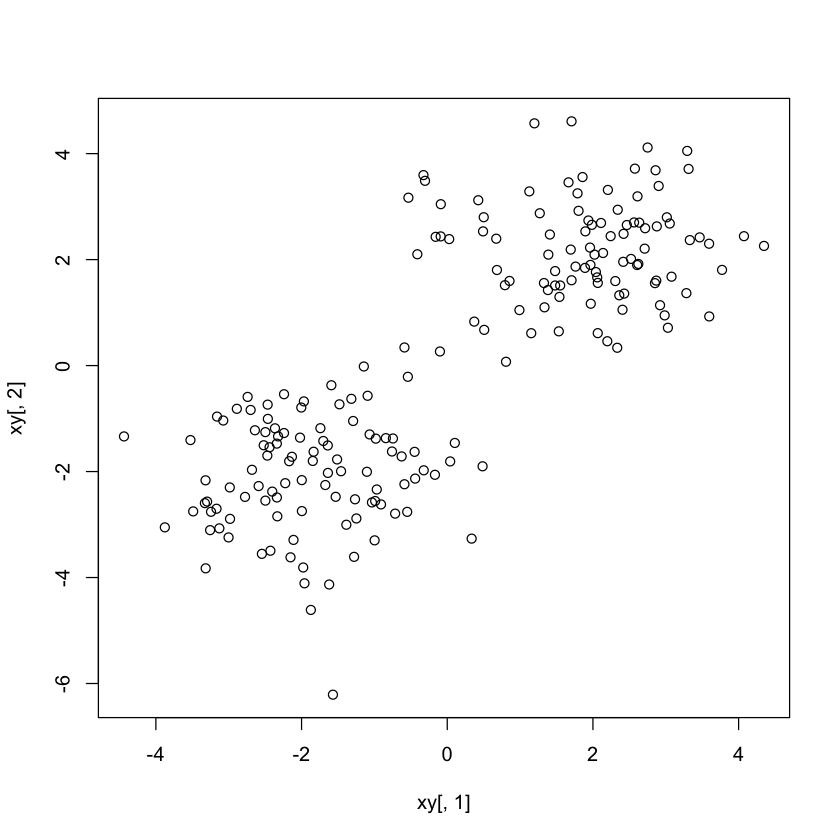

In [1]:
remove(list=ls())
set.seed(15)
n <- 100
center <- 2
x <- c(rnorm(n, mean=-center, sd=1), rnorm(n, mean=center, sd=1))
y <- c(rnorm(n, mean=-center, sd=1), rnorm(n, mean=center, sd=1))

xy <- cbind(x,y)

plot(xy[,1], xy[,2])

# Fitting hierarchical clustering 

Now we implement agglomerative clustering using the average linkage. There are several ways we use the hclust command.

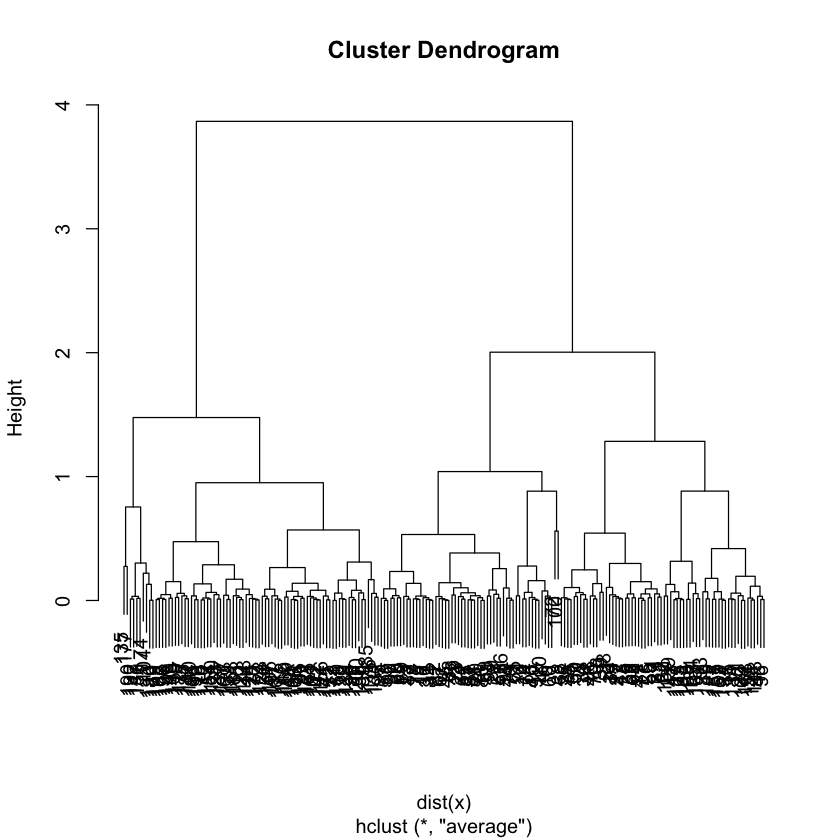

In [2]:
xy_hclust <- hclust(dist(x), method="average")
plot(xy_hclust)

The dendrogram class is a more flexible class for plotting the tree.

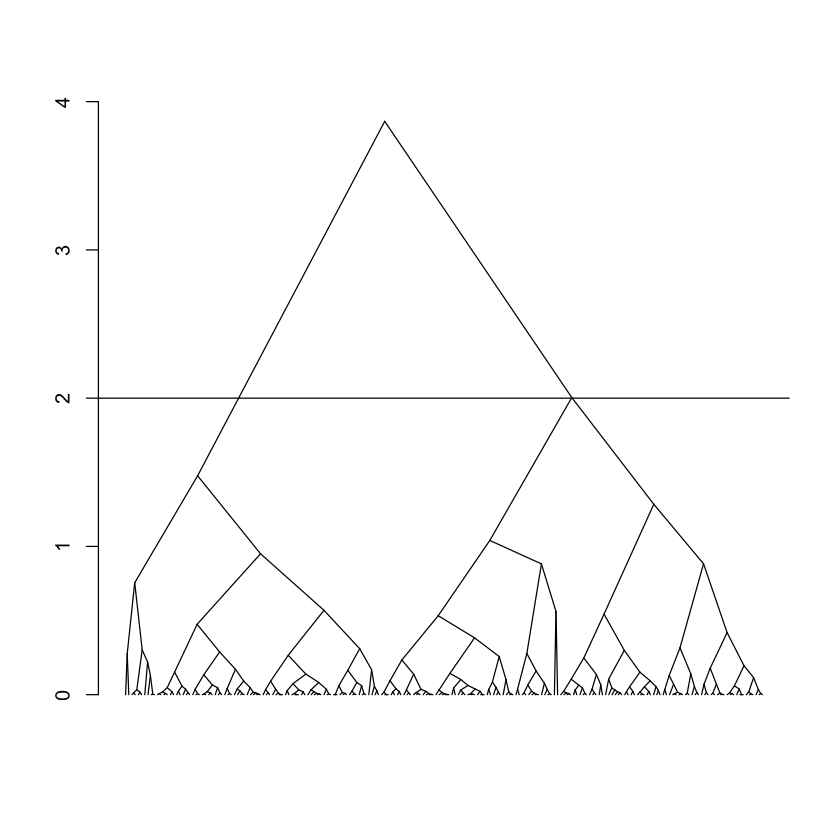

In [3]:
xy_dendro <- as.dendrogram(xy_hclust)
plot(xy_dendro, leaflab="none",type="triangle")
abline(h=2)

In [4]:
? plot.dendrogram

dendrogram {stats},R Documentation
object,"any R object that can be made into one of class ""dendrogram""."
"x, y","object(s) of class ""dendrogram""."
hang,numeric scalar indicating how the height of leaves should be computed from the heights of their parents; see plot.hclust.
check,"logical indicating if object should be checked for validity. This check is not necessary when x is known to be valid such as when it is the direct result of hclust(). The default is check=TRUE, e.g. for protecting against memory explosion with invalid inputs."
type,type of plot.
center,"logical; if TRUE, nodes are plotted centered with respect to the leaves in the branch. Otherwise (default), plot them in the middle of all direct child nodes."
edge.root,"logical; if true, draw an edge to the root node."
nodePar,"a list of plotting parameters to use for the nodes (see points) or NULL by default which does not draw symbols at the nodes. The list may contain components named pch, cex, col, xpd, and/or bg each of which can have length two for specifying separate attributes for inner nodes and leaves. Note that the default of pch is 1:2, so you may want to use pch = NA if you specify nodePar."
edgePar,"a list of plotting parameters to use for the edge segments and labels (if there's an edgetext). The list may contain components named col, lty and lwd (for the segments), p.col, p.lwd, and p.lty (for the polygon around the text) and t.col for the text color. As with nodePar, each can have length two for differentiating leaves and inner nodes."
leaflab,"a string specifying how leaves are labeled. The default ""perpendicular"" write text vertically (by default). ""textlike"" writes text horizontally (in a rectangle), and ""none"" suppresses leaf labels."


In [5]:
xy_group <- cutree(xy_hclust, k=2)

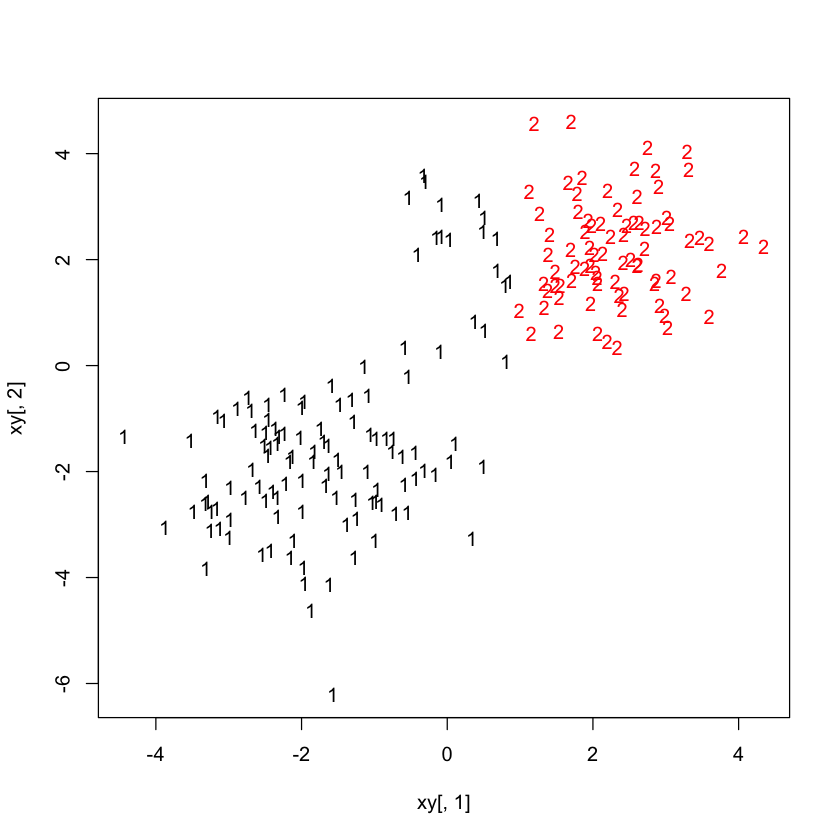

In [6]:
plot(xy[,1],xy[,2],col=xy_group, pch=paste(xy_group))

# Exercise
Run a dendrogram on motor cars data


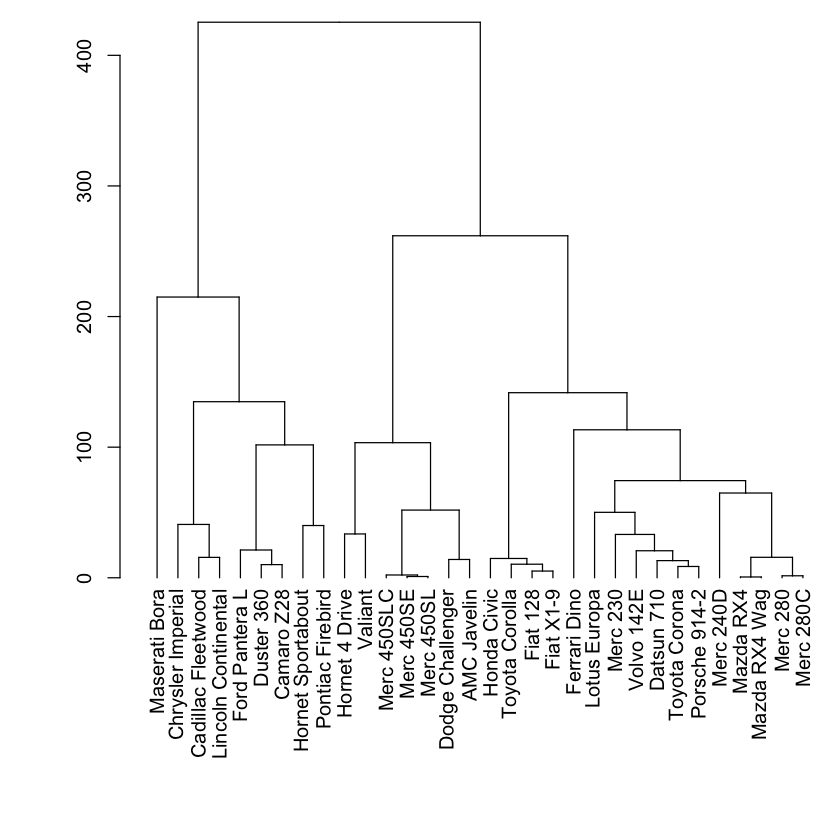

In [7]:
data(mtcars)
par(mar=c(10,5,0,0))
plot(as.dendrogram(hclust(dist(mtcars))))

# Fitting K-Means
The k-means algorithm is one of the most efficient clustering techniques. It starts with some initial value, often $k$ random samples of the observations. Then, iteratively clusters the closest observations to the mean, and then updates the cluster mean accordingly.

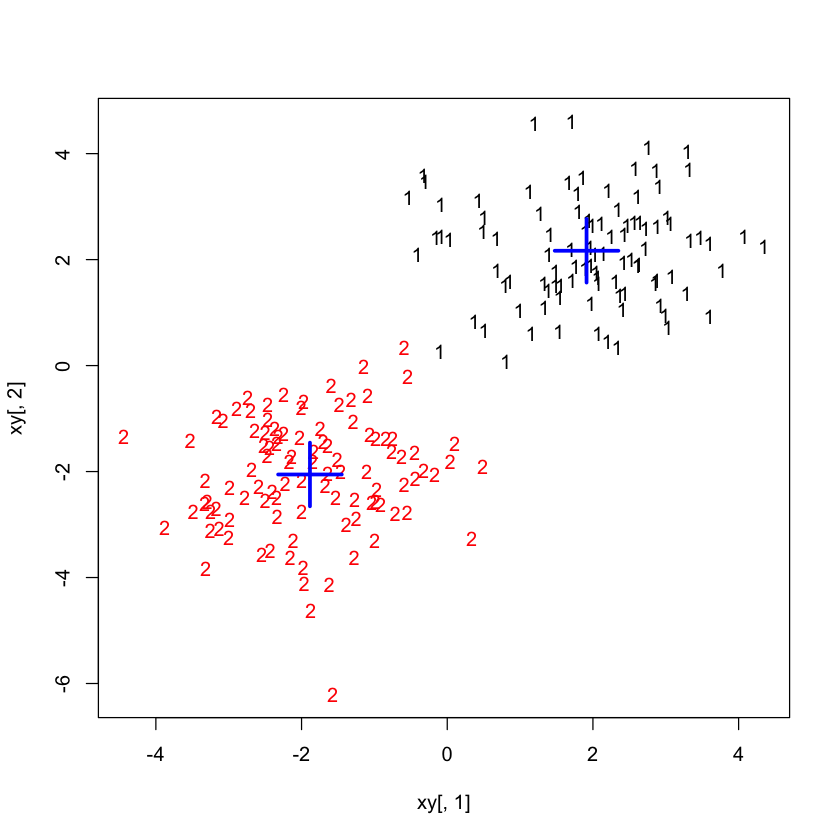

In [8]:
xy_kmeans=kmeans(xy,centers=2)
plot(xy[,1],xy[,2],col=xy_kmeans$cluster, pch=paste(xy_kmeans$cluster))
points(xy_kmeans$centers[,1],xy_kmeans$centers[,2],pch=3,lwd=3,col="blue",cex=5)

## Image processing application
Now we try kmeans on the grayscale cat image of chapter 2 and segment the image.

Warning message:
: package ‘imager’ was built under R version 3.2.5Loading required package: plyr
Loading required package: magrittr

Attaching package: ‘imager’

The following object is masked from ‘package:magrittr’:

    add

The following object is masked from ‘package:plyr’:

    liply

The following objects are masked from ‘package:stats’:

    convolve, spectrum

The following object is masked from ‘package:graphics’:

    frame

The following object is masked from ‘package:base’:

    save.image



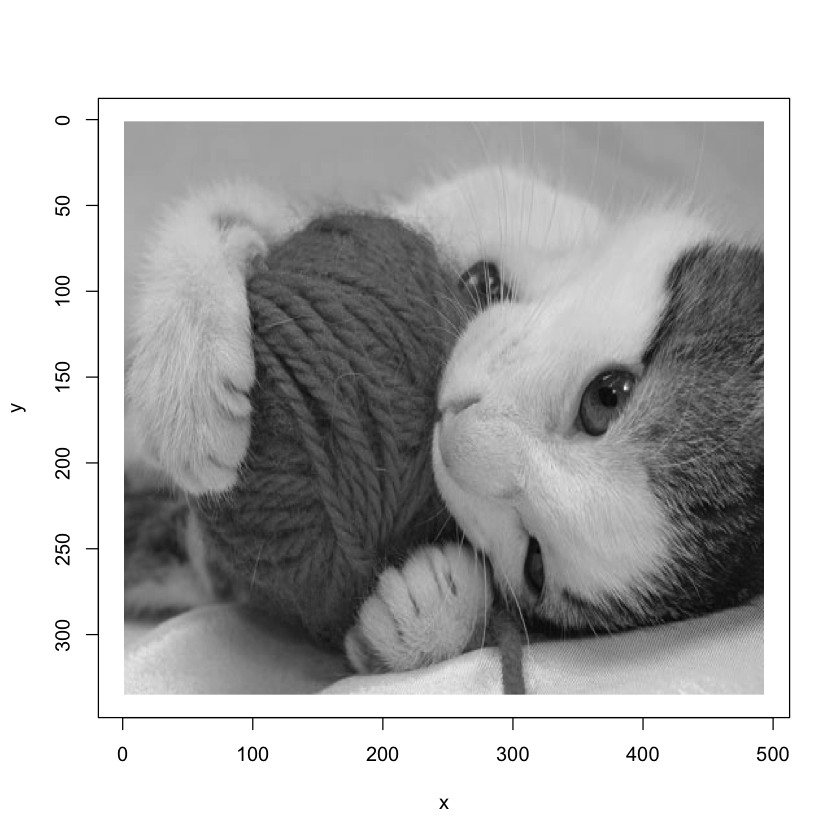

In [9]:
library(imager)
# Iyou may need to install mageMagick library
#url="http://img.webmd.com/dtmcms/live/webmd/consumer_assets/site_images/articles/health_tools/is_my_cat_normal_slideshow/photolibrary_rf_photo_of_cat_eating_red_yarn.jpg"
cat <- load.image("../data/cat1.jpg")
catgray<-grayscale(cat)
plot(catgray)

In [10]:
dim(cat)
dim(catgray)
nrow <- dim(catgray)[1]
ncol <- dim(catgray)[2]


[1] 493 335   1   3

[1] 493 335   1   1

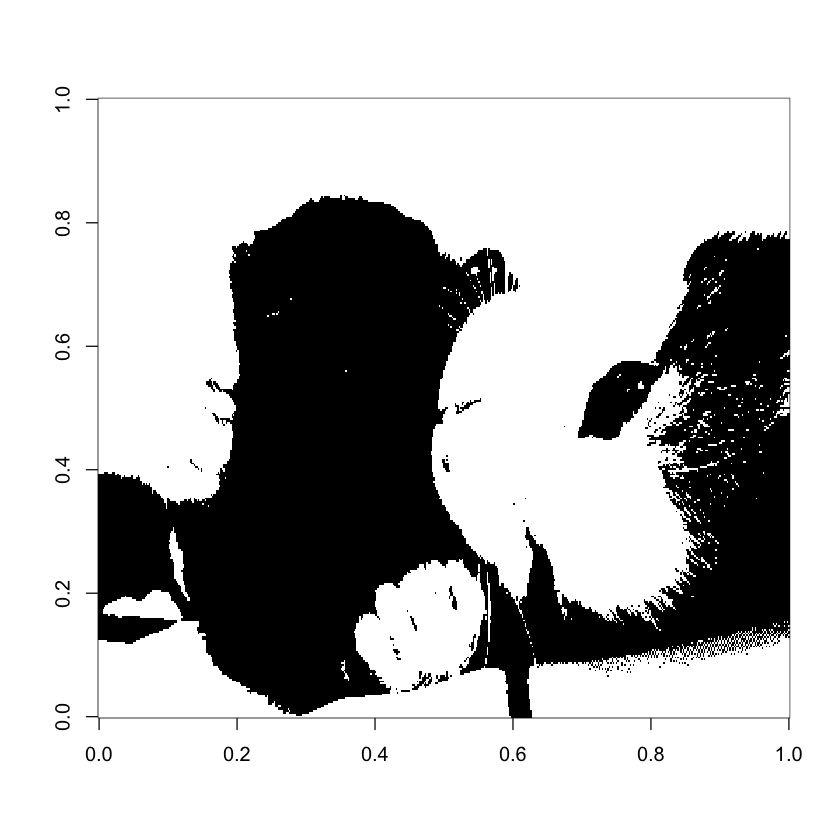

In [11]:
cat_kmeans<-kmeans(as.vector(catgray),centers=2)
image(matrix(cat_kmeans$cluster,nrow,ncol)[,335:1],col=c("black","white"))